In [26]:
try:
  import google.colab
  print("In Colab")
  %cd /content
  !git clone https://github.com/mistake0316/CLIPStyleTransfer.git
  %cd /content/CLIPStyleTransfer
except:
  print("Not in Colab")
  pass

In Colab
/content
fatal: destination path 'CLIPStyleTransfer' already exists and is not an empty directory.
/content/CLIPStyleTransfer


In [27]:
!nvidia-smi

Wed Jan 26 09:39:38 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.46       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    33W / 250W |  11779MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Install & Import & Config

In [28]:
#@title intsall
!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-in0zqpln
  Running command git clone -q https://github.com/openai/CLIP.git /tmp/pip-req-build-in0zqpln


In [29]:
#@title import
import torch
import torchvision.transforms as T
from utils.stylePredictor26 import pretrainedStylePredictor
from utils.transform26 import pretrainedGhiasi

import clip
from utils.clip_loss import CLIPLoss
from PIL import Image

import torchvision.transforms as T
from tqdm.auto import tqdm

import numpy as np
import matplotlib.pyplot as plt

import imageio

In [30]:
#@title config
resize_flag = True       #@param ["True", "False"] {type:"raw"}
center_crop_flag = True  #@param ["True", "False"] {type:"raw"}
content_cap = 384 #@param {type:"number"}
style_size = 256  #edit this will make wierd initial style

content_image_path = "doge.jpg" #@param {type:"string"}
optimize_steps = 100 #@param {type:"number"}
gif_frames = 30 #@param {type:"number"}

save_step = optimize_steps//gif_frames
clip_loss_weight = 1 #@param {type:"number"}
l2_loss_weight = 0 #@param {type:"number"}

save_folder = "result_with_aug" #@param {type:"string"}

lr = 0.01 #@param {type:"number"}

assert optimize_steps >= gif_frames
assert clip_loss_weight > 0
assert l2_loss_weight >= 0

In [31]:
#@title Augmentator Config
aug_times = 32 #@param {type:"number"}

affine_param = dict()
affine_param["degrees"] = 180 #@param {type:"number"}
affine_param["shear"] = 5 #@param {type:"number"}
affine_param["scale"] = (1, 1.5) #@param {type:"raw"}

color_param = dict()
color_param["brightness"] = 0.1 #@param {type:"number"}
color_param["contrast"] = 0.1 #@param {type:"number"}
color_param["saturation"] = 0.1 #@param {type:"number"}
color_param["hue"] = 0.1 #@param {type:"number"}

Aug = torch.nn.Sequential(
  T.RandomAffine(
    degrees=affine_param["degrees"],
    shear=affine_param["shear"],
    scale=affine_param["scale"],
  ),
  T.ColorJitter(
    brightness=color_param["brightness"],
    contrast=color_param["contrast"],
    saturation=color_param["saturation"],
    hue=color_param["hue"],
  ),
  T.RandomCrop(content_cap),
)

aug_fun = lambda img: torch.cat([Aug(img) for _ in range(aug_times)])

In [22]:
#@title load models
print("loading models")
device = ["cpu", "cuda"][torch.cuda.is_available()]
print(f"device : {device}")
SP = pretrainedStylePredictor().to(device).eval()
G = pretrainedGhiasi().to(device).eval()
clip_loss = CLIPLoss(content_cap, device).eval()
print("done")

loading models
device : cuda
done


In [32]:
#@title define preprocesser
style_preprocess = torch.nn.Sequential(
  T.Resize(style_size,),
  T.CenterCrop(style_size),
  torch.nn.AvgPool2d(kernel_size=3,stride=1)
)

content_preprocess = torch.nn.Sequential()
if resize_flag:
  content_preprocess.add_module("resize", T.Resize(content_cap,))
if center_crop_flag:
  content_preprocess.add_module("center_crop",T.CenterCrop(content_cap),)

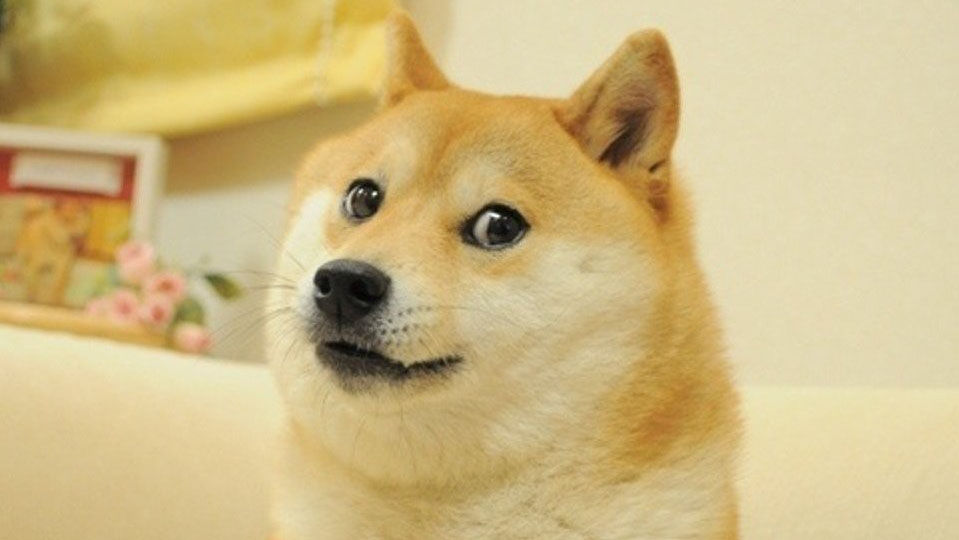

In [33]:
content = Image.open(content_image_path).convert('RGB')
content

# Go get encode

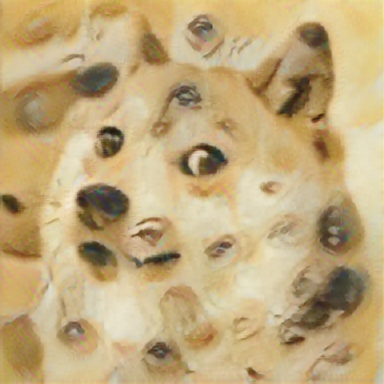

In [34]:
#@title reconstruct with Ghiasi's style transfer model

content_tensor = T.ToTensor()(content)
content_tensor = content_preprocess(content_tensor)

style_tensor = T.ToTensor()(content)
style_tensor = style_preprocess(style_tensor)

content_tensor = content_tensor.unsqueeze(0).to(device)
style_tensor = style_tensor.unsqueeze(0).to(device)
with torch.no_grad():
  style_code = SP(style_tensor)
  result = G(content_tensor, style_code)

T.ToPILImage()(result.squeeze().cpu())

# Go CLIP

In [35]:
def tensor_to_numpy_image(tensor):
  return (255*tensor.detach().squeeze().cpu().permute(1,2,0).numpy()).astype(np.uint8)

In [36]:
text_list = """\
mosaic
honey
starry night
cheese cake\
"""

In [37]:
from pathlib import Path
Path(save_folder).mkdir(parents=True, exist_ok=True)

  0%|          | 0/4 [00:00<?, ?it/s]

mosaic


  0%|          | 0/100 [00:00<?, ?it/s]

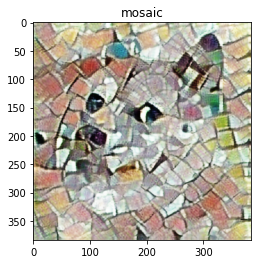

honey


  0%|          | 0/100 [00:00<?, ?it/s]

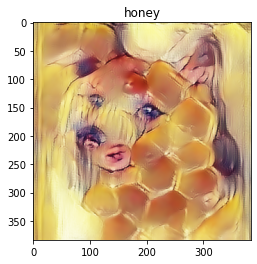

starry night


  0%|          | 0/100 [00:00<?, ?it/s]

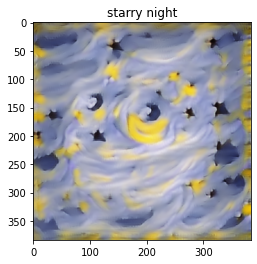

cheese cake


  0%|          | 0/100 [00:00<?, ?it/s]

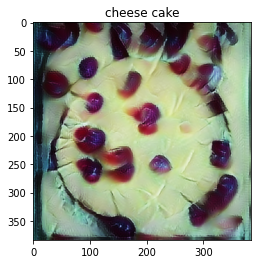

In [38]:
#@title generate loop
for text in tqdm(text_list.split("\n")):
  print(text)
  tokens = clip.tokenize([text]).to(device)
  code = style_code.clone()
  code.requires_grad_()
  optimizer = torch.optim.Adam([code],lr=lr)

  saved_code = []
  saved_result = []

  for idx in tqdm(range(optimize_steps)):
    result = G(content_tensor, code)
    
    aug_result = aug_fun(result)
    
    c_loss = torch.mean(clip_loss(aug_result, tokens))
    l2_loss = torch.sum((code-style_code)**2)

    loss = clip_loss_weight*c_loss + l2_loss_weight*l2_loss

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (idx+1)%save_step == 0:
      saved_code.append(code.detach())
      saved_result.append(result.detach())
  
  
  plt.imshow(
    np.asarray(T.ToPILImage()(result.squeeze()))
  )
  plt.title(text)
  plt.show()
  
  imageio.mimwrite(f"{save_folder}/{text}.gif", [*map(tensor_to_numpy_image, saved_result)])

In [39]:
from IPython.display import display
from IPython.display import Image as IPython_Image
import glob
import os

result_with_aug/mosaic.gif


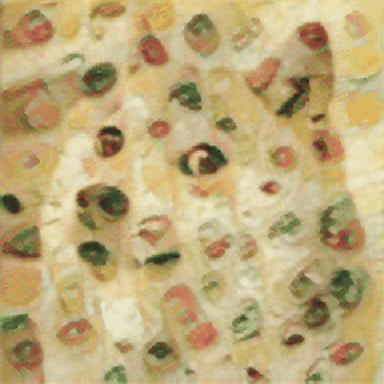

result_with_aug/honey.gif


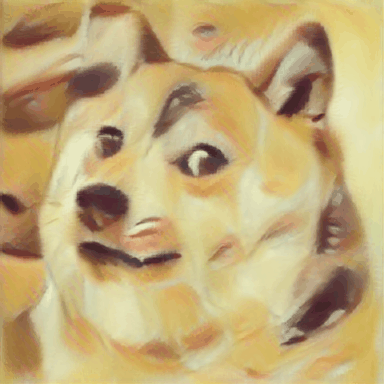

result_with_aug/starry night.gif


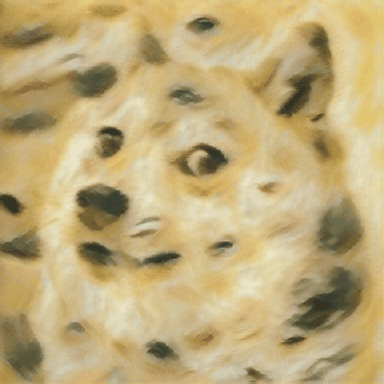

result_with_aug/cheese cake.gif


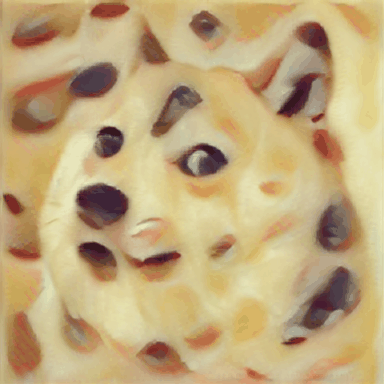

In [40]:
for filepath in sorted(glob.glob(f"{save_folder}/*.gif"), key=os.path.getmtime):
  print(filepath)
  display(IPython_Image(open(filepath,'rb').read()))